# 3D-Clustering of toy examples

Toy examples for the binding_sites_clustering

PDB code            Protein name                            Type of binding site            

1. 1yer             HSP90                                   Subpocket                       
2. 1pw6             IL-2                                    Adjacent pocket                 
3. 3zln, 3qkd       BCL-XL                                  Breath motion                   
4. 1cz2 (model 2&8) ns-LTP                                  Channel/Tunnel                  
5. 1kv1, 1ny3       P38 MAPK                                Allosteric pocket               
6. 3ptb             bovine ß-trysin                         Potential multiple binding sites
7. 3hvc             MAPK                                    Potential multiple binding sites
8. 4f9w             MAPK                                    Potential multiple binding sites
9. 3cpa             Carboxy-peptidase                       Potential multiple binding sites
10. 1qcf            HCK (haematopoetic cell kinase)         Potential multiple binding sites
11. 1h61            pemtaerythritol tetranitrate kinase     Potential multiple binding sites
12. 2bal            MAPK                                    Potential multiple binding sites
13. 1hvy            thymidylate synthase                    Potential multiple binding sites
14. 3g5d            tyrosine-protein kinase src             Potential multiple binding sites
15. 1be9            PDZ-domain                              Potential multiple binding sites
16. 6o0k            BCL-2                                   Single binding site
17. 1ubq            Ubiqutin                                No ligand binding site         
18. 4pti            BPTI (Bovie pancreatic trysin inhibitor)No ligand binding site                               
19. 1ao6            Serum albumin                           No ligand binding site  sites                                                   

These files in the folder "/Users/nicha/dev/Protein-preparation-pipeline/data/toy_examples_clustering".

The prediction of the binding site residues are in the file "results_*.csv"

In [1]:
# The necessary libraries for the project and the data path
datapath = "/Users/nicha/dev/Protein-preparation-pipeline/data/toy_examples_clustering"

import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from math import e
from pymol import cmd
from Bio import PDB
import plotly.express as px

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

import py3Dmol
import matplotlib.cm as cm
import matplotlib.colors as mcolors

In [2]:
# Function to prepare the dataset for clustiring


def extract_residue_coordinates(pdb_file, residue_number, chain_id="A"):
    coordinates = []
    try:
        with open(pdb_file, "r") as file:
            for line in file:
                if line.startswith(("ATOM", "HETATM")) and line[21] == chain_id:
                    resi = int(line[22:26].strip())
                    if resi == residue_number:
                        atom_type = line[76:78].strip()
                        x = float(line[30:38].strip())
                        y = float(line[38:46].strip())
                        z = float(line[46:54].strip())
                        coordinates.append((atom_type, x, y, z))
    except FileNotFoundError:
        print(f"Error: File {pdb_file} not found.")
    except Exception as e:
        print(f"Unexpected error: {e}")
    return coordinates


def calculate_weighted_center_of_mass(coordinates):
    total_weight = 0
    weighted_coords = np.zeros(3)
    atomic_weights = {"H": 1.008, "C": 12.011, "N": 14.007, "O": 15.999, "S": 32.06}

    for atom_type, x, y, z in coordinates:
        weight = atomic_weights.get(atom_type.upper(), 1.0)
        weighted_coords += np.array([x, y, z]) * weight
        total_weight += weight

    return np.round(weighted_coords / total_weight, 3).tolist()


def process_pdb_file(data_path, file_name, df):
    pdb_file = os.path.join(data_path, f"{file_name}.pdb")
    csv_file = os.path.join(data_path, f"results_{file_name}.csv")

    try:
        df = pd.read_csv(csv_file, usecols=lambda column: not column.startswith("Unnamed"))
        for index, row in df.iterrows():
            residue_number = row["resi"]
            chain_id = row["chain"]
            coordinates = extract_residue_coordinates(pdb_file, residue_number, chain_id)
            if coordinates:
                center_of_mass = calculate_weighted_center_of_mass(coordinates)
                df.loc[index, "resn_coordinates"] = str(coordinates)
                df.loc[index, ["center_of_mass_x", "center_of_mass_y", "center_of_mass_z"]] = center_of_mass
            else:
                print(f"Residue {residue_number} in chain {chain_id} not found in {pdb_file}.")
    except FileNotFoundError:
        print(f"Error: {csv_file} or {pdb_file} not found.")
    except Exception as e:
        print(f"Unexpected error: {e}")
    return df


def process_and_update_pdb_data(data_path: str, pdb_code: str):
    """
    Process a PDB file and corresponding CSV file to extract residue information and update the DataFrame.

    Args:
        data_path (str): Path to the directory containing the PDB and CSV files.
        pdb_code (str): PDB code of the protein.

    Returns:
        pd.DataFrame: Updated DataFrame with extracted residue information.
    """
    try:
        # Construct file paths for the CSV and PDB files
        csv_file_path = f"{data_path}/results_{pdb_code}.csv"
        pdb_file_path = f"{data_path}/{pdb_code}.pdb"

        # Read the CSV file
        df = pd.read_csv(csv_file_path)

        # Process the PDB file and update the DataFrame
        df_updated = process_pdb_file(data_path, pdb_code, df)

        # Save the updated DataFrame to a new CSV file
        output_csv_path = f"{data_path}/results_{pdb_code}_updated.csv"
        df_updated.to_csv(output_csv_path, index=False)
        print(f"Updated results saved to: {output_csv_path}")

        return df_updated

    except Exception as e:
        print(f"Error while processing {pdb_code}: {e}")
        return None

def process_all_pdb_files(data_path: str):
    """
    Process all PDB-related files in the given data path, update the DataFrame for each, 
    and combine the results into a single DataFrame.

    Args:
        data_path (str): Path to the directory containing the PDB and CSV files.

    Returns:
        pd.DataFrame: Combined DataFrame with data from all processed files.
    """
    combined_df = pd.DataFrame()  # Initialize an empty DataFrame to store combined results

    for file in os.listdir(data_path):
        # Identify result CSV files with a format like 'results_<pdb_code>.csv'
        if file.startswith("results_") and file.endswith(".csv"):
            pdb_code = file.split("_")[1].split(".")[0]  # Extract PDB code from the file name
            print(f"Processing PDB code: {pdb_code}")

            # Call the process_and_update_pdb_data function for each PDB code
            updated_df = process_and_update_pdb_data(data_path, pdb_code)

            if updated_df is not None:
                # Add a new column with the PDB code to the updated DataFrame
                updated_df["PDBcode"] = pdb_code

                # Append the updated DataFrame to the combined DataFrame
                combined_df = pd.concat([combined_df, updated_df], ignore_index=True)

    combined_df.drop_duplicates(inplace=True)  # Remove any duplicate rows

    # Save the combined DataFrame to a new CSV file
    combined_csv_path = f"{data_path}/combined_results.csv"
    combined_df.to_csv(combined_csv_path, index=False)
    print(f"Combined results saved to: {combined_csv_path}")

    return combined_df

def plot_3d_cluster(df, color_column):
    """
    Create an interactive 3D scatter plot.

    Args:
        df (pd.DataFrame): DataFrame containing the data to plot.
        color_column (str): Column name to use for coloring the points.
    """
    # Create an interactive 3D scatter plot with smaller marker size
    fig = px.scatter_3d(df, x='center_of_mass_x', y='center_of_mass_y', z='center_of_mass_z', color=color_column, 
                        title='3D Scatter Plot of Binding Residues', 
                        labels={'center_of_mass_x': 'X Coordinate', 'center_of_mass_y': 'Y Coordinate', 'center_of_mass_z': 'Z Coordinate'})
    fig.update_traces(marker=dict(size=5), textfont_size=12)  # Adjust marker size and text size
    fig.update_layout(width=1000, height=800)  # Optional: Adjust plot size

    # Display the plot
    fig.show()


def plot_3d_pbind_cluster(df, color_column):
    """Create two 3D scatter plots side by side using matplotlib.

    Args:
        df (pd.DataFrame): DataFrame containing the data to plot.
        color_column (str): Column name to use for coloring the points.
    """
    fig = plt.figure(figsize=(14, 7))

    # Create the first 3D scatter plot with the color column
    ax1 = fig.add_subplot(121, projection='3d')
    scatter1 = ax1.scatter(df['center_of_mass_x'], df['center_of_mass_y'], df['center_of_mass_z'], 
                           c=df[color_column], cmap='viridis', s=20)
    ax1.set_title('3D Scatter Plot of Binding Residues (Color by Cluster)')
    ax1.set_xlabel('X Coordinate')
    ax1.set_ylabel('Y Coordinate')
    ax1.set_zlabel('Z Coordinate')
    fig.colorbar(scatter1, ax=ax1, label=color_column)

    # Create the second 3D scatter plot with the p(bind) column
    ax2 = fig.add_subplot(122, projection='3d')
    scatter2 = ax2.scatter(df['center_of_mass_x'], df['center_of_mass_y'], df['center_of_mass_z'], 
                           c=df['p(bind)'], cmap='plasma', s=20)
    ax2.set_title('3D Scatter Plot of Binding Residues (Color by p(bind))')
    ax2.set_xlabel('X Coordinate')
    ax2.set_ylabel('Y Coordinate')
    ax2.set_zlabel('Z Coordinate')
    fig.colorbar(scatter2, ax=ax2, label='p(bind)')

    plt.tight_layout()
    plt.show()


def visualize_protein_ligand_with_pbind(pdb_file, residue_data, title=None):
    """
    Visualize a protein structure and ligand with protein colored by `p(bind)` values.

    Args:
        pdb_file (str): Path to the PDB file.
        residue_data (pd.DataFrame): DataFrame containing residue information with columns ['chain', 'resi', 'p(bind)'].
        title (str): Title of the plot (default is the pdb file name).

    Returns:
        py3Dmol.view: A 3Dmol.js viewer instance displaying the protein and ligand structure.
    """
    # Use the provided title or derive it from the pdb_file
    if title is None:
        title = f"Protein Visualization: {pdb_file.split('/')[-1]}"
    
    # Set up color map for p(bind)
    cmap = cm.get_cmap('viridis')  # Use viridis colormap
    ligand_color = "red"

    # Create a py3Dmol viewer
    viewer = py3Dmol.view(width=800, height=400)
    
    # Load the PDB structure into the viewer
    with open(pdb_file, 'r') as pdb:
        viewer.addModel(pdb.read(), 'pdb')

    # Set the default style for the protein
    viewer.setStyle({'cartoon': {'color': 'white'}})

    # Apply color to protein residues based on `p(bind)`
    for _, row in residue_data.iterrows():
        pbind_color = mcolors.to_hex(cmap(row['p(bind)']))  # Directly use p(bind) without normalization
        viewer.addStyle({'chain': row['chain'], 'resi': int(row['resi'])}, {'cartoon': {'color': pbind_color}})

    # Highlight the ligand distinctly
    viewer.addStyle({'hetflag': True}, {'stick': {'color': ligand_color}})
    
    # Zoom to fit the entire structure
    viewer.zoomTo()

    # Create a legend for the colormap
    fig, ax = plt.subplots(figsize=(5, 1))
    norm = mcolors.Normalize(vmin=0, vmax=1)
    cb = plt.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap), ax=ax, orientation='horizontal')
    cb.set_label("p(bind) values")
    plt.title(title)
    plt.show()

    # Display the structure
    viewer.show()
    return viewer

import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm
import py3Dmol

def visualize_protein_ligand_with_pbind(pdb_file, residue_data, title=None):
    """
    Visualize a protein structure and ligand with protein colored by `p(bind)` values.

    Args:
        pdb_file (str): Path to the PDB file.
        residue_data (pd.DataFrame): DataFrame containing residue information with columns ['chain', 'resi', 'p(bind)'].
        title (str): Title of the plot (default is the pdb file name).

    Returns:
        py3Dmol.view: A 3Dmol.js viewer instance displaying the protein and ligand structure.
    """
    # Use the provided title or derive it from the pdb_file
    if title is None:
        title = f"Protein Visualization: {pdb_file.split('/')[-1]}"
    
    # Set up color map for p(bind)
    cmap = plt.colormaps['viridis']  # Use the new colormap API
    ligand_color = "red"

    # Create a py3Dmol viewer
    viewer = py3Dmol.view(width=800, height=400)
    
    # Load the PDB structure into the viewer
    with open(pdb_file, 'r') as pdb:
        viewer.addModel(pdb.read(), 'pdb')

    # Set the default style for the protein
    viewer.setStyle({'cartoon': {'color': 'white'}})

    # Apply color to protein residues based on `p(bind)`
    for _, row in residue_data.iterrows():
        pbind_color = mcolors.to_hex(cmap(row['p(bind)']))  # Directly use p(bind) without normalization
        viewer.addStyle({'chain': row['chain'], 'resi': int(row['resi'])}, {'cartoon': {'color': pbind_color}})

    # Highlight the ligand distinctly
    viewer.addStyle({'hetflag': True}, {'stick': {'color': ligand_color}})
    
    # Zoom to fit the entire structure
    viewer.zoomTo()

    # Create a legend for the colormap
    fig, ax = plt.subplots(figsize=(5, 1))
    norm = mcolors.Normalize(vmin=0, vmax=1)
    cb = plt.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap), ax=ax, orientation='horizontal')
    cb.set_label("p(bind) values")
    plt.title(title)
    plt.show()

    # Display the structure
    viewer.show()
    return viewer

def visualize_protein_with_ligand_pbind_threshold(pdb_file, residue_data, pbind_threshold=0.7):
    """
    Visualize a protein structure with highlighted residues and ligands using py3Dmol.

    Args:
        pdb_file (str): Path to the PDB file.
        residue_data (pd.DataFrame): DataFrame containing residue information with columns ['chain', 'resi', 'p(bind)'].
        pbind_threshold (float): Threshold for p(bind) to highlight residues (default is 0.7).

    Returns:
        py3Dmol.view: A 3Dmol.js viewer instance displaying the protein structure.
    """
    # Create a py3Dmol viewer
    viewer = py3Dmol.view(width=800, height=400)
    
    # Load the PDB structure into the viewer
    with open(pdb_file, 'r') as pdb:
        viewer.addModel(pdb.read(), 'pdb')
    
    # Set the default style for the protein
    viewer.setStyle({'cartoon': {'color': 'grey'}})
    
    # Highlight residues with high p(bind)
    for _, row in residue_data.iterrows():
        if row['p(bind)'] > pbind_threshold:
            viewer.addStyle({'chain': row['chain'], 'resi': int(row['resi'])}, {'stick': {'color': 'red'}})
    
    # Highlight ligands
    viewer.addStyle({'hetflag': True}, {'stick': {'colorscheme': 'yellowCarbon'}})
    
    # Zoom to fit the entire structure
    viewer.zoomTo()
    
    # Display the structure
    viewer.show()
    return viewer
# Example usage
#plot_3d_scatter(features_1hvy, 'kmean_cluster')

#### Data preparation

- Read results filed from AF2Bind in the datapath
- Extract the coordinate of the heavy atoms of each residue
- Calculate the center of mass of all the heavy atoms of each residue
- Save all the data in one dataframe

In [3]:
# Execute the functions to extract and process the data
data_path = "/Users/nicha/dev/Protein-preparation-pipeline/data/toy_examples_clustering"

# Process all files and get the combined DataFrame
combined_df = process_all_pdb_files(data_path)

# Preview the combined DataFrame
print(combined_df.head())

Processing PDB code: 1qcf
Updated results saved to: /Users/nicha/dev/Protein-preparation-pipeline/data/toy_examples_clustering/results_1qcf_updated.csv
Processing PDB code: 1ubq
Updated results saved to: /Users/nicha/dev/Protein-preparation-pipeline/data/toy_examples_clustering/results_1ubq_updated.csv
Processing PDB code: 3g5d
Updated results saved to: /Users/nicha/dev/Protein-preparation-pipeline/data/toy_examples_clustering/results_3g5d_updated.csv
Processing PDB code: 3zln
Updated results saved to: /Users/nicha/dev/Protein-preparation-pipeline/data/toy_examples_clustering/results_3zln_updated.csv
Processing PDB code: 4f9w
Updated results saved to: /Users/nicha/dev/Protein-preparation-pipeline/data/toy_examples_clustering/results_4f9w_updated.csv
Processing PDB code: 1lyz
Updated results saved to: /Users/nicha/dev/Protein-preparation-pipeline/data/toy_examples_clustering/results_1lyz_updated.csv
Processing PDB code: 1hvy
Updated results saved to: /Users/nicha/dev/Protein-preparation

In [7]:
combined_df.PDBcode.unique()

array(['1qcf', '1ubq', '3g5d', '3zln', '4f9w', '1lyz', '1hvy', '3hvc',
       '3cpa', '1pw6', '1ema', '1kv1', '3ptb', '6o0k', '2bal', '4pti',
       '1yer', '1cz2', '3qkd', '1ao6', '1h61', '1ny3'], dtype=object)

Extract the dataframe for each PDB code and check whether the the total entries and everthing is fine

In [6]:
# Extract the residue coordinates and calculate the center of mass for each residue for all the pdb files
# Create a dictionary of dataframes grouped by PDBcode
dfs = {pdb: df for pdb, df in combined_df.groupby('PDBcode')}

# Check if the extracted dataframes have the same total entries as the original CSV files
for pdb in combined_df['PDBcode'].unique():
    original_csv_path = os.path.join(datapath, f"results_{pdb}.csv")
    original_df = pd.read_csv(original_csv_path)
    extracted_df = dfs[pdb]
    
    if len(original_df) == len(extracted_df):
        print(f"{pdb}: Match - {len(original_df)} entries")
    else:
        print(f"{pdb}: Mismatch - Original: {len(original_df)} entries, Extracted: {len(extracted_df)} entries")

1qcf: Match - 450 entries
1ubq: Match - 76 entries
3g5d: Match - 256 entries
3zln: Match - 144 entries
4f9w: Match - 336 entries
1lyz: Match - 129 entries
1hvy: Match - 288 entries
3hvc: Match - 327 entries
3cpa: Match - 307 entries
1pw6: Match - 121 entries
1ema: Match - 225 entries
1kv1: Match - 331 entries
3ptb: Match - 220 entries
6o0k: Match - 141 entries
2bal: Match - 338 entries
4pti: Match - 58 entries
1yer: Match - 207 entries
1cz2: Match - 90 entries
3qkd: Match - 140 entries
1ao6: Match - 578 entries
1h61: Match - 364 entries
1ny3: Match - 277 entries


In [ ]:
# Arch Function to prepare the dataset for the clustering


# def xextract_residue_coordinates(pdb_file, residue_number, chain_id="A",):
#     coordinates = []  # A list to store the extracted coordinates and atom types.

#     # Open the PDB file for reading
#     with open(pdb_file, 'r') as file:
#         for line in file:
#             # Check if the line starts with 'ATOM' or 'HETATM'
#             if line.startswith(('ATOM', 'HETATM')) and line[21] == chain_id:
#                 resi = int(line[22:26].strip())  # Extract the residue number from the PDB line.
#                 if resi == residue_number:  # Check if the residue number matches the target.
#                     # Extract the atom type (columns 77-78 in the PDB format)
#                     atom_type = line[76:78].strip()
#                     # Extract the x, y, z coordinates (columns 31-54 in the PDB format)
#                     x = float(line[30:38].strip())
#                     y = float(line[38:46].strip())
#                     z = float(line[46:54].strip())
#                     # Append the atom type and coordinates as a tuple (atom_type, x, y, z) to the list
#                     coordinates.append((atom_type, x, y, z))

#     return coordinates

# def xcalculate_center_coordinatex(coordinates):
#     """
#     Calculate the center of mass for a set of coordinates.

#     Args:
#         coordinates (list of tuples): List of (x, y, z) coordinates.

#     Returns:
#         tuple: Center of mass coordinates (x, y, z).
#     """
#     if not coordinates:
#         return (None, None, None)

#     x_coords, y_coords, z_coords = zip(*[(x, y, z) for _, x, y, z in coordinates])
#     print(x_coords)
#     center_of_mass = (np.round(np.mean(x_coords), 3), np.round(np.mean(y_coords), 3), np.round(np.mean(z_coords), 3))
#     return center_of_mass

# def xcalculate_weighted_center_of_massx(coordinates):
#     """
#     Calculate the weighted center of mass for a set of coordinates based on atomic weights.

#     Args:
#         coordinates (list of tuples): List of (atom_type, x, y, z) coordinates.

#     Returns:
#         List[float]: Weighted center of mass coordinates [x, y, z].
#     """
#     total_weight = 0
#     weighted_coords = np.zeros(3)
#     atomic_weights = {"H": 1.008, "C": 12.011, "N": 14.007, "O": 15.999, "S": 32.06}

#     for atom_type, x, y, z in coordinates:
#         weight = atomic_weights.get(atom_type.upper(), 1.0)  # Default to 1.0 if the element is unknown
#         weighted_coords += np.array([x, y, z]) * weight
#         total_weight += weight

#     return np.round(weighted_coords / total_weight, 3).tolist()

# def xcalculate_center_of_mass_pymol(coordinates):
#     """
#     Calculate the center of mass for a set of coordinates using PyMOL.

#     Args:
#         coordinates (list of tuples): List of (x, y, z) coordinates.

#     Returns:
#         tuple: Center of mass coordinates (x, y, z).
#     """
#     if not coordinates:
#         return (None, None, None)

#     # Create a temporary object in PyMOL with the given coordinates
#     #cmd.delete("temp_obj")
#     cmd.load_cgo([coord for xyz in coordinates for coord in (9.0, *xyz)], "temp_obj")

#     # Calculate the center of mass
#     pymol_com = cmd.centerofmass("temp_obj")
#     cmd.delete("temp_obj")

#     return round(pymol_com[1], 3), round(pymol_com[2], 3), round(pymol_com[3], 3)

# def xprocess_pdb_file(data_path, df):    
#     """
#     Process a PDB file and corresponding CSV file to extract residue coordinates and update the DataFrame.

#     Args:
#         pdb_file (str): Path to the PDB file.
#         csv_file (str): Path to the CSV file.

#     Returns:
#         pd.DataFrame: Updated DataFrame with residue coordinates.
#     """
#     pdbcode = file.split("_")[1].split(".")[0]
#     pdb_file = f"{file_path}/{pdbcode}.pdb"
#     csv_file = f"{file_path}/results_{pdbcode}.csv"
#     # read the csv file
#     df = pd.read_csv(csv_file, usecols=lambda column: not column.startswith('Unnamed'))
#     for index, row in df.iterrows():
#         residue_number = row["resi"]
#         chain_id = row["chain"]
#         coordinates = extract_residue_coordinates(pdb_file, residue_number, chain_id)
#         df.loc[index, "resn_coordinates"] = coordinates
#         center_of_mass = calculate_weighted_center_of_mass(coordinates)
#         df.loc[index, "center_of_mass_x","center_of_mass_y","center_of_mass_z" ] = f"{center_of_mass[0]:.3f}, {center_of_mass[1]:.3f}, {center_of_mass[2]:.3f}"
#     return df

# pdb_file = f"{pwd}/6m17.pdb"  # Replace with your actual PDB file path

# # Extract coordinates and update the DataFrame
# df_ace2 = extract_residue_coordinates(pdb_file, df_ace2)

# # Display the updated DataFrame
# df_ace2.head()

# # Example usage
# coordinates = extract_residue_coordinates(f"{datapath}/6o0k.pdb", "A",201 )
# print(coordinates)
# center_coor = calculate_center_coordinate(coordinates)
# print(f"Center of coordinate: {center_coor}")
# center_of_mass = calculate_weighted_center_of_mass(coordinates)
# print(f"Center of weight mass: {center_of_mass}")
# #center_of_mass_pymol = calculate_center_of_mass_pymol(coordinates)
# #print(f"Center of mass pymol: {center_of_mass_pymol}")


# # center_of_mass = calculate_center_of_mass_pymol(coordinates)
# # print(center_of_mass)
# # extract_residue_coordinates(f"{datapath}/6o0k.pdb", "A", 9)

In [134]:
# Arch: from the 3D-clustering Function to get the center of mass of a residue

# def calculate_weighted_center_of_mass(residue):
#     """
#     Calculate the weighted center of mass for a residue based on atomic weights.

#     Args:
#         residue: A Biopython Residue object.

#     Returns:
#         List[float]: Weighted center of mass coordinates [x, y, z].
#     """
#     total_weight = 0
#     weighted_coords = np.zeros(3)
#     for atom in residue.get_atoms():
#         weight = atom.element.upper()
#         atomic_weights = {"H": 1.008, "C": 12.011, "N": 14.007, "O": 15.999, "S": 32.06}
#         weight = atomic_weights.get(weight, 1.0)  # Default to 1.0 if the element is unknown
#         weighted_coords += np.array(atom.coord) * weight
#         total_weight += weight

#     return (weighted_coords / total_weight).tolist()

# def print_residue_coordinates(residue):
#     """
#     Print the coordinates of atoms in a residue using PyMOL.

#     Args:
#         residue: A Biopython Residue object.
#     """
#     chain_id = residue.get_parent().id
#     res_num = residue.id[1]

#     # Create a selection string for PyMOL
#     selection = f"chain {chain_id} and resi {res_num}"

#     # Select the residue in PyMOL
#     cmd.select("my_selection", selection)

#     # Get the model of the selected residue
#     model = cmd.get_model("my_selection")

#     # Print the coordinates of each atom in the residue
#     for atom in model.atom:
#         print(f"Atom {atom.name} in Residue {chain_id}{res_num}: {atom.coord}")

# def extract_residue_coordinates(pdb_file, df):
#     """
#     Extract weighted center of mass of residues from a PDB file and add to a DataFrame.

#     Args:
#         pdb_file (str): Path to the PDB file.
#         df (pd.DataFrame): DataFrame containing residue information (chain and residue number)

#     Returns:
#         pd.DataFrame: Updated DataFrame with 3D coordinates.
#     """
#     parser = PDB.PDBParser(QUIET=True)
#     structure = parser.get_structure("protein", pdb_file)

#     x_coords, y_coords, z_coords = [], [], []

#     for _, row in df.iterrows():
#         chain_id = row['chain']
#         res_num = row['resi']

#         try:
#             residue = structure[0][chain_id][res_num]
#             coords = calculate_weighted_center_of_mass(residue)  # Use weighted CoM
#             x_coords.append(coords[0])
#             y_coords.append(coords[1])
#             z_coords.append(coords[2])
#         except KeyError:
#             x_coords.append(np.nan)
#             y_coords.append(np.nan)
#             z_coords.append(np.nan)

#     df['x'] = np.round(x_coords, 3)
#     df['y'] = np.round(y_coords, 3)
#     df['z'] = np.round(z_coords, 3)
#     return df

# from pymol import cmd


        
# def process_pdb_file(pdbcode, df):    
#     """
#     Process a PDB file and corresponding CSV file to extract residue coordinates and update the DataFrame.

#     Args:
#         pdb_file (str): Path to the PDB file.
#         csv_file (str): Path to the CSV file.

#     Returns:
#         pd.DataFrame: Updated DataFrame with residue coordinates.
#     """
#     pdbcode = file.split("_")[1].split(".")[0]
#     pdb_file = f"{file_path}/{pdbcode}.pdb"
#     csv_file = f"{file_path}/results_{pdbcode}.csv"
#     df = pd.read_csv(csv_file, usecols=lambda column: not column.startswith('Unnamed'))
#     df = extract_residue_coordinates(pdb_file, df)
#     return df

# # Example usage
# pdb_file = f"{datapath}/1hvy.pdb"
# csv_file = f"{datapath}/results_1hvy.csv"
# df_1hvy = process_pdb_file(pdb_file, csv_file)
# df_1hvy.head()

# # Example usage
# # Assuming you have a Biopython Residue object named `residue`
# # print_residue_coordinates(residue)

# # Example usage

# # # Ensure 'chain' and 'resi' columns exist in the DataFrame
# # if 'chain' not in df_ace2.columns or 'resi' not in df_ace2.columns:
# #     raise ValueError("DataFrame must contain 'chain' and 'resi' columns")

# # # Path to the PDB file
# # pdb_file = f"{pwd}/6m17.pdb"  # Replace with your actual PDB file path

# # # Extract coordinates and update the DataFrame
# # df_ace2 = extract_residue_coordinates(pdb_file, df_ace2)

# # # Display the updated DataFrame
# # df_ace2.head()



### Statistical value of the binding residue probability

In [145]:
# Get the statistical information about the binding probability

# Ensure the column name matches the DataFrame's column names
# Check the exact spelling and case of the column name in the DataFrame
if 'PDBcode' not in combined_df.columns:
    raise KeyError("Column 'PDBcode' not found in the DataFrame. Check the column names.")

# Initialize an empty DataFrame to store statistics
stats = pd.DataFrame(columns=['pdbcode', 'mean', 'std', 'min', '25%', '50%', '75%', 'max'])

# Iterate through each unique PDB code in the combined data
for pdbcode in combined_df['PDBcode'].unique():
    # Filter rows corresponding to the current PDB code
    df_pdbcode = combined_df[combined_df['PDBcode'] == pdbcode]

    # Calculate descriptive statistics for the 'p(bind)' column
    if 'p(bind)' in df_pdbcode.columns:
        desc = df_pdbcode['p(bind)'].describe().round(3)
        # Append the statistics to the stats DataFrame
        stats = pd.concat([
            stats,
            pd.DataFrame({
                'pdbcode': [pdbcode],
                'mean': [desc['mean']],
                'std': [desc['std']],
                'min': [desc['min']],
                '25%': [desc['25%']],
                '50%': [desc['50%']],
                '75%': [desc['75%']],
                'max': [desc['max']]
            })
        ], ignore_index=True)
    else:
        print(f"Column 'p(bind)' not found for PDB code {pdbcode}. Skipping...")

stats.head(n=20)

/var/folders/v4/rd2_123918b6cj4v96gtlmkh0000gn/T/ipykernel_15213/1230064050.py:20: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  stats = pd.concat([


,pdbcode,mean,std,min,25%,50%,75%,max
0,1qcf,0.058,0.115,0.001,0.006,0.016,0.052,0.939
1,1ubq,0.123,0.148,0.003,0.026,0.072,0.156,0.659
2,4f9w,0.094,0.164,0.001,0.010,0.028,0.090,0.936
3,1lyz,0.157,0.235,0.004,0.021,0.048,0.131,0.939
4,1hvy,0.137,0.247,0.000,0.005,0.017,0.127,0.988
5,3hvc,0.107,0.173,0.001,0.014,0.034,0.116,0.972
6,1pw6,0.156,0.208,0.001,0.015,0.057,0.216,0.921
7,1ema,0.125,0.194,0.001,0.009,0.037,0.138,0.908
8,1kv1,0.113,0.204,0.001,0.009,0.025,0.102,0.981
9,2bal,0.082,0.149,0.001,0.009,0.023,0.071,0.927


### Check whether there are obvious trend in the binding probability

- Visualize the binding probability of each toy examples with boxplot

    - The maximum binding probability does not imply the type of binding site.
    - NO obvious trend in the binding probability 
    - Can not use any arbitary value of the bindding probability as threshold to cluster them

-> Cluster the binding residues coordinates with their corresponding binding probability

-> Test the Cutoff calculation based on the mean and standard deviation of binding probabilities
 

/var/folders/v4/rd2_123918b6cj4v96gtlmkh0000gn/T/ipykernel_15213/642474500.py:19: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




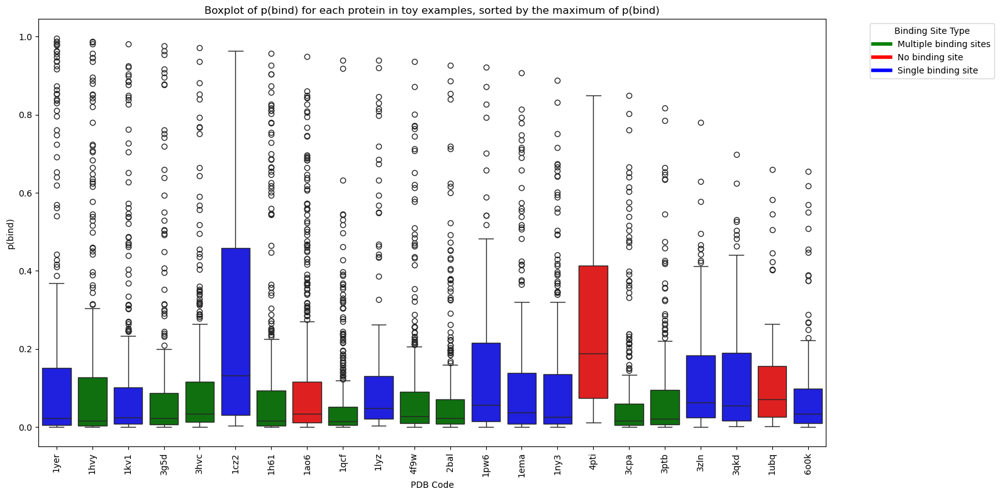

In [275]:
# Visualize the distribution of binding probabilities using a box plot
from matplotlib.lines import Line2D 
# Example lists for multiple binding site (mbs) and no binding site (nbs) proteins
mbs = ['3ptb', '3hvc', '4f9w', '3cpa', '1qcf', '1h61', '2bal', '1hvy', '3g5d', '1be9']
nbs = ['1ubq', '4pti', '1ao6']

# Copy the combined DataFrame and calculate the max p(bind) for each PDB code
sorted_combined_data = combined_df.copy()
sorted_combined_data['max_pbind'] = sorted_combined_data.groupby('PDBcode')['p(bind)'].transform('max')
sorted_combined_data.sort_values(by='max_pbind', ascending=False, inplace=True)

# Plot all box plots in the same figure
plt.figure(figsize=(16, 8))

# Define the color palette based on PDB codes
palette = {pdb: 'green' if pdb in mbs else 'red' if pdb in nbs else 'blue' 
           for pdb in sorted_combined_data['PDBcode'].unique()}

sns.boxplot(x='PDBcode', y='p(bind)', data=sorted_combined_data, palette=palette)
plt.xticks(rotation=90)
plt.title('Boxplot of p(bind) for each protein in toy examples, sorted by the maximum of p(bind)')
plt.xlabel('PDB Code')
plt.ylabel('p(bind)')

# Create a custom legend
custom_lines = [
    Line2D([0], [0], color='green', lw=4, label='Multiple binding sites'),
    Line2D([0], [0], color='red', lw=4, label='No binding site'),
    Line2D([0], [0], color='blue', lw=4, label='Single binding site')
]
plt.legend(handles=custom_lines, title='Binding Site Type', bbox_to_anchor=(1.05, 1), loc='upper left')

# Show the plot
plt.tight_layout()
plt.show()

# Visualize each Multiple binding site proteins colored by the binding probability

- Color based on the binding probability 
- True ligand shows in Red.

**Observation**

- The AF2bind predicts protein only chain A by default. 
-> Implement a python file to predict all the chain: af2bind_all_chains.py

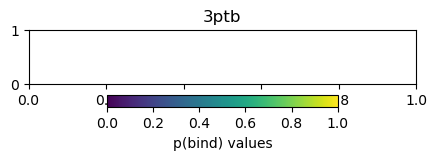

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

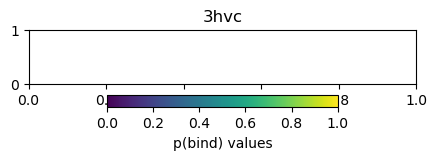

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

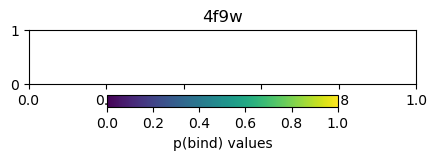

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

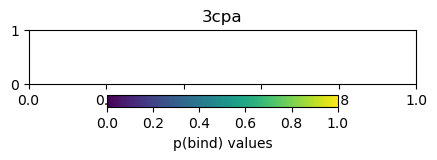

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

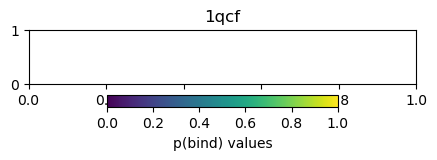

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

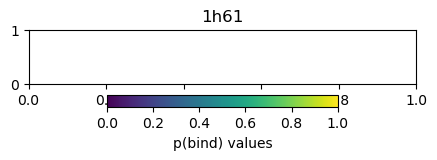

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

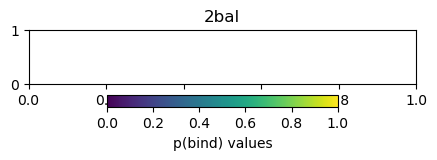

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

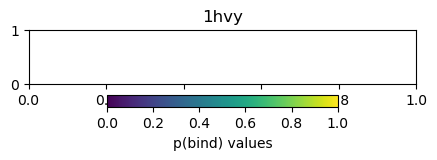

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

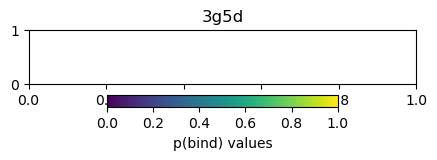

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [326]:
# Visualize each protein structure with the binding probability colored by cluster
mbs = ['3ptb', '3hvc', '4f9w', '3cpa', '1qcf', '1h61', '2bal', '1hvy', '3g5d']
nbs = ['1ubq', '4pti', '1ao6']
for pdbcode in mbs:
    # Visualize the protein structure with the binding probability colored by cluster
    visualize_protein_ligand_with_pbind(f"{datapath}/{pdbcode}.pdb", dfs[pdbcode], title=pdbcode)

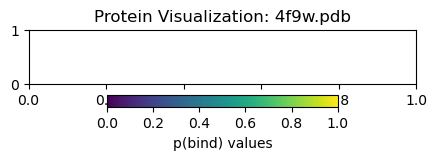

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [323]:
pdb_file = f"{datapath}/4f9w.pdb"

# Visualize the protein and ligand
viewer = visualize_protein_ligand_with_pbind(pdb_file, dfs['4f9w'])

In [316]:
pdb_file = f"{datapath}/1qcf.pdb"

# Visualize the protein and ligand
viewer = visualize_protein_ligand_with_pbind(pdb_file, dfs['1qcf'])

/var/folders/v4/rd2_123918b6cj4v96gtlmkh0000gn/T/ipykernel_15213/624334452.py:196: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



3Dmol.js failed to load for some reason. Please check your browser console for error messages.

## Visualize the no binding site protein

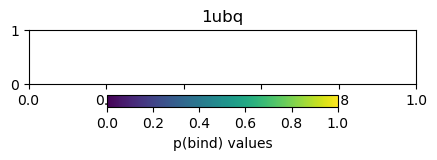

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

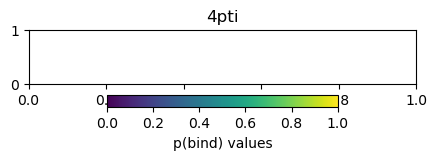

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

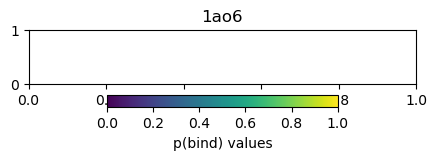

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [327]:
nbs = ['1ubq', '4pti', '1ao6']
for pdbcode in nbs:
    # Visualize the protein structure with the binding probability colored by cluster
    visualize_protein_ligand_with_pbind(f"{datapath}/{pdbcode}.pdb", dfs[pdbcode], title=pdbcode)

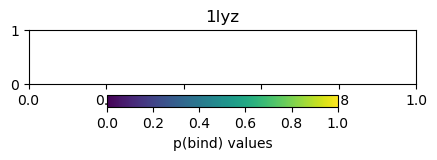

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

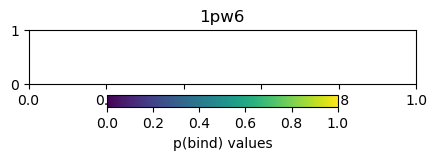

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

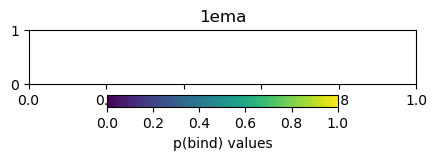

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

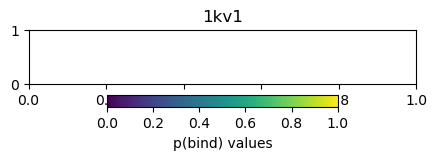

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

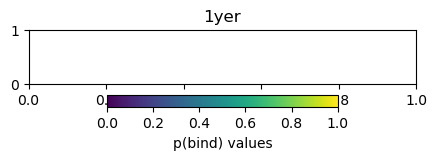

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

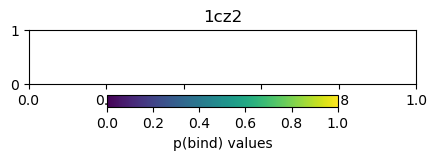

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

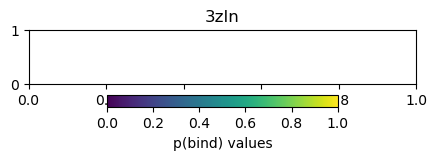

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

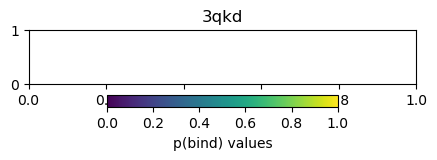

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

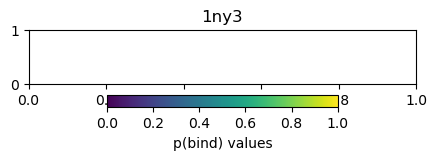

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

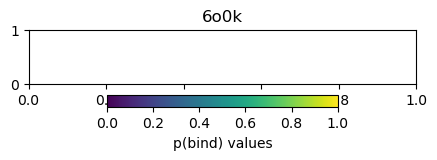

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [328]:
all_pdb = combined_df['PDBcode'].unique()

# get the list of pdb code that is not mbs nor nbs
others = [pdb for pdb in all_pdb if pdb not in mbs and pdb not in nbs]

for pdbcode in others:
    # Visualize the protein structure with the binding probability colored by cluster
    visualize_protein_ligand_with_pbind(f"{datapath}/{pdbcode}.pdb", dfs[pdbcode], title=pdbcode)

In [313]:
nbs = ['1ubq', '4pti', '1ao6']

for pdbcode in nbs:
    # Visualize the protein structure with the binding probability colored by cluster
    visualize_protein_ligand_with_pbind(f"{datapath}/{pdbcode}.pdb", dfs[pdbcode], title=pdbcode)

/var/folders/v4/rd2_123918b6cj4v96gtlmkh0000gn/T/ipykernel_15213/624334452.py:196: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [312]:
pdb_file = f"{datapath}/3g5d.pdb"

# Visualize the protein and ligand
viewer = visualize_protein_ligand_with_pbind(pdb_file, dfs['3g5d'])

/var/folders/v4/rd2_123918b6cj4v96gtlmkh0000gn/T/ipykernel_15213/624334452.py:196: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



3Dmol.js failed to load for some reason. Please check your browser console for error messages.

## Clustering approaches

For each approache I want to try different clustering methods e.g. Qualitty clustering, Kmean clustering, Spectral clustering

1. Clustering data: The 3D coordinates of residues + their binding probability 

2. Clustering data: The 3D coordinates of residues only

    2.1 Cutoff calculation based on the mean and standard deviation of binding probabilities

    2.2 and 2.3 With Arbitary top-n or binding probability: This option with be ignored first, since we saw that there is no obvious trend to be seen in the boxplot of each type of binding site proteins


I want to start with the 1hvy and 2bal: both are multiple binding sites proteins

1hvy: Multiple Binding Sites proteins with 4 chains

- Human thymidylate synthase complexed with dUMP and Raltitrexed, an antifolate drug, is in the closed conformation
- D16: TOMUDEX
- UMP: dUMP
- BME: 2-MERCAPTOETHANOL

In [311]:
pdb_file = f"{datapath}/1hvy.pdb"

# Visualize the protein and ligand
viewer = visualize_protein_ligand_with_pbind(pdb_file, dfs['1hvy'])

/var/folders/v4/rd2_123918b6cj4v96gtlmkh0000gn/T/ipykernel_15213/624334452.py:196: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [170]:
# Visualize 1hvy: Multiple Binding Sites proteins with 2 chains
## Human thymidylate synthase complexed with dUMP and Raltitrexed, an antifolate drug, is in the closed conformation
### D16: TOMUDEX
### UMP: dUMP
### BME: 2-MERCAPTOETHANOL

view = nglview.show_structure_file(f"{data_path}/1hvy.pdb")
view.center()
view._remote_call('setSize', target='Widget', args=['120%', '600px'])
view

NGLWidget()

In [172]:
## p38alpha MAP kinase bound to pyrazoloamine
### PQA: Pyrazoloamine
view = nglview.show_structure_file(f"{data_path}/2bal.pdb")
view.center()
view._remote_call('setSize', target='Widget', args=['120%', '600px'])
view

NGLWidget()

In [310]:
pdb_file = f"{datapath}/2bal.pdb"

# Visualize the protein and ligand
viewer = visualize_protein_ligand_with_pbind(pdb_file, dfs['2bal'])

/var/folders/v4/rd2_123918b6cj4v96gtlmkh0000gn/T/ipykernel_15213/624334452.py:196: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [175]:
# Extract the features from the combined_df: center_of_mass_x, center_of_mass_y, center_of_mass_z, p(bind)
features_1hvy = combined_df[['center_of_mass_x', 'center_of_mass_y', 'center_of_mass_z', 'p(bind)']].loc[combined_df['PDBcode'] == '1hvy']
features_2bal = combined_df[['center_of_mass_x', 'center_of_mass_y', 'center_of_mass_z', 'p(bind)']].loc[combined_df['PDBcode'] == '2bal']
features_2bal.head()

,center_of_mass_x,center_of_mass_y,center_of_mass_z,p(bind)
2283,-25.337,-0.541,9.361,0.048333
2284,-23.894,-3.340,11.304,0.035970
2285,-26.390,-3.308,15.027,0.003430
2286,-23.763,0.506,15.296,0.005121
2287,-23.173,-0.625,21.507,0.002326


In [268]:
features_2bal.duplicated().sum()

0

In [280]:
features_1hvy.duplicated().sum()

0

In [279]:
features_1hvy.drop_duplicates(inplace=True)

1. Spectral clustering: 

- Use the Clustering eigenvalue gap to identify the number of the expected cluster first

--> This doesnt seem to be useful

- The 1hvy: this only seems to identify the dimer of the protein. As shown in the visualization above, the 3D structure has 2 chains and are dimer to each other. However, according to the eigenvalue gap this suggest to have 300 cluster.

- Also in the 2bal case, doesnt seem to make any sense as it suggest to have 300 cluster as well.

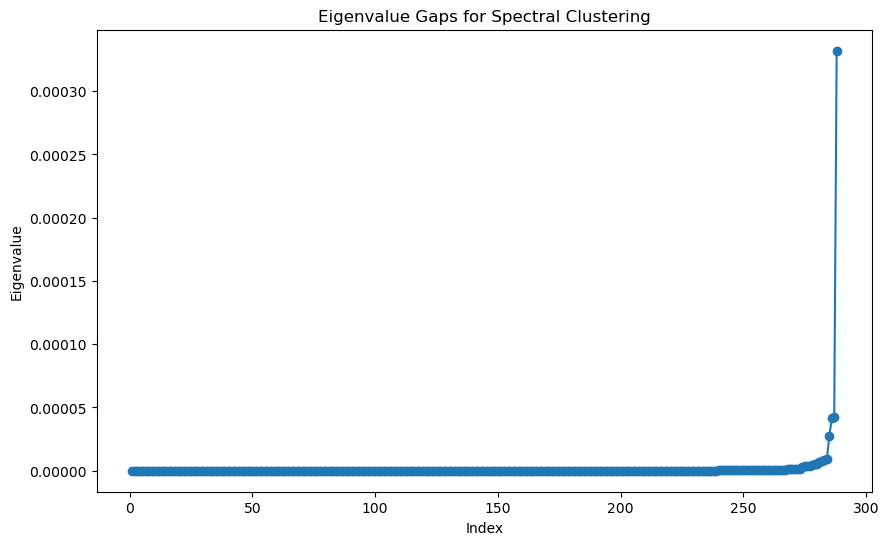

In [281]:
# Try the Spectral Clustering Eigenvalue Gap:
### The eigenvalue gap is the difference between consecutive eigenvalues of the Laplacian matrix
from sklearn.cluster import SpectralClustering
from sklearn.metrics.pairwise import rbf_kernel
from scipy.linalg import eigh

# Compute similarity matrix using RBF kernel
similarity_matrix = rbf_kernel(features_1hvy, gamma=1.0)
laplacian = np.diag(np.sum(similarity_matrix, axis=1)) - similarity_matrix
eigenvalues, eigenvectors = eigh(laplacian)

# Plot the eigenvalues gaps
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(eigenvalues)+1), eigenvalues, marker='o')
plt.title("Eigenvalue Gaps for Spectral Clustering")
plt.xlabel("Index")
plt.ylabel("Eigenvalue")
plt.show()

This plot appears to show eigenvalues from a spectral clustering algorithm, plotted in ascending order of their index. Here’s how to interpret it:

1. Eigenvalues and Clustering
	•	Eigenvalues represent information about the structure of your data in the context of spectral clustering.
	•	In spectral clustering, eigenvalues of the Laplacian matrix are computed. Small eigenvalues close to zero indicate connected components (or clusters) in the data.

2. The Key Idea
	•	The gaps between consecutive eigenvalues help determine the optimal number of clusters.
	•	Specifically:
	•	The number of eigenvalues close to 0 often corresponds to the number of clusters.
	•	A large jump (gap) between two consecutive eigenvalues indicates the transition to higher dimensions, where clusters are less distinct.

3. Interpreting the Plot
	•	Flat Region (Close to Zero): The eigenvalues near zero suggest the presence of well-defined clusters.
	•	Large Jump (Gap): The sudden increase (e.g., between ~300 and 310 on the index) indicates that the optimal number of clusters may be around 300. Eigenvalues beyond this jump represent noise or higher-dimensional structures not useful for clustering.

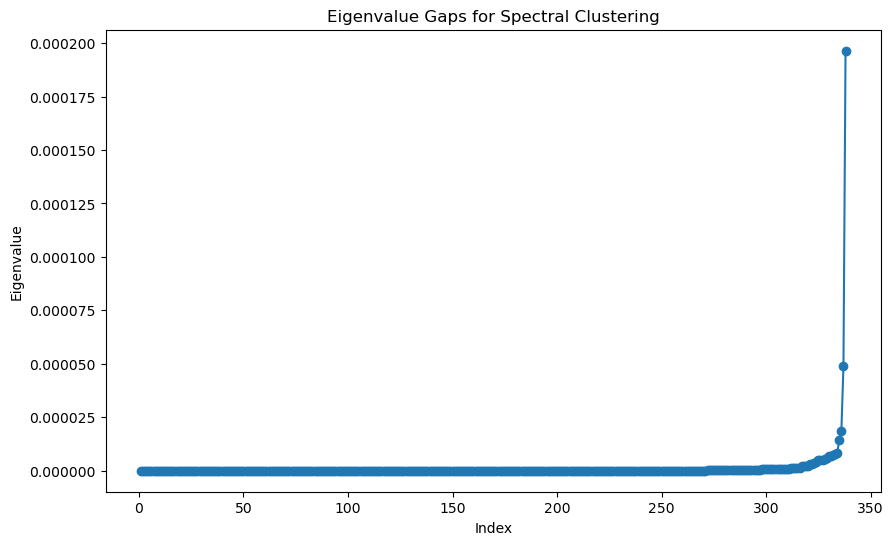

In [282]:
# Eigenvalue Gap for 2bal
# Compute similarity matrix using RBF kernel
similarity_matrix = rbf_kernel(features_2bal, gamma=1.0)
laplacian = np.diag(np.sum(similarity_matrix, axis=1)) - similarity_matrix
eigenvalues, eigenvectors = eigh(laplacian)

# Plot the eigenvalues gaps
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(eigenvalues)+1), eigenvalues, marker='o')
plt.title("Eigenvalue Gaps for Spectral Clustering")
plt.xlabel("Index")
plt.ylabel("Eigenvalue")
plt.show()

How to Interpret:

1.	Eigenvalues on Y-axis: These represent the sorted eigenvalues of the Laplacian matrix derived from your data. Smaller eigenvalues close to zero typically indicate tight clusters, while larger eigenvalues suggest separation between clusters.

2.	Index on X-axis: This is the index of the eigenvalues in ascending order.
	
3.	Sharp Increase (Gap):
	•	The plot shows a sharp increase in eigenvalues around index 300.
	•	This jump suggests that the data has approximately 300 clusters, as the eigenvalues before the jump correspond to clusters that are tightly connected within themselves.
	•	The eigenvalues after the jump are larger, indicating separation or noise.

Conclusion:

The plot supports that there are likely 300 meaningful clusters in your data because the eigenvalues remain near zero until approximately index 300. Beyond this, the eigenvalues increase significantly, which often reflects noise or disconnected components. This is consistent with how spectral clustering identifies clusters based on the eigenvalue gap.

In [284]:
# Example eigenvalues from your plot (replace this with your actual data)
eigenvalues = np.zeros(600)  # Simulated eigenvalues with a jump
eigenvalues[:300] = 0.01  # Simulated "near-zero" region for clusters
eigenvalues[300:] = np.linspace(1, 2, 300)  # Simulated jump

# Define a threshold to determine "close to zero"
threshold = 0.05

# Count the number of eigenvalues below the threshold
num_clusters = np.sum(eigenvalues < threshold)

print(f"Number of clusters suggested by the eigenvalue gaps: {num_clusters}")

Number of clusters suggested by the eigenvalue gaps: 300


2. Kmean 

- To estimate the optimal the number of the cluster
    - Sihouette Analysis: min cluster test = 2, choose the k with the highest score.
    - Elbow methode: min cluster tested = 1
        - Steps for Elbow Method:
	1.	Calculate Inertia:
	    - Inertia measures the sum of squared distances between each point and the centroid of its cluster. Lower inertia means better clustering.
	2.	Plot the Elbow Curve:
	    - Plot the number of clusters (k) on the x-axis and the inertia values on the y-axis.
	3.	Locate the Elbow Point:
	    - The optimal k is typically at the “elbow” of the curve, where the *rate of decrease in inertia slows down significantly*.
	    - This point indicates a trade-off between the number of clusters and the clustering quality.
	4.	Automatic Detection (Optional):
	    - Use the second derivative of the inertia curve to identify the “elbow” mathematically.



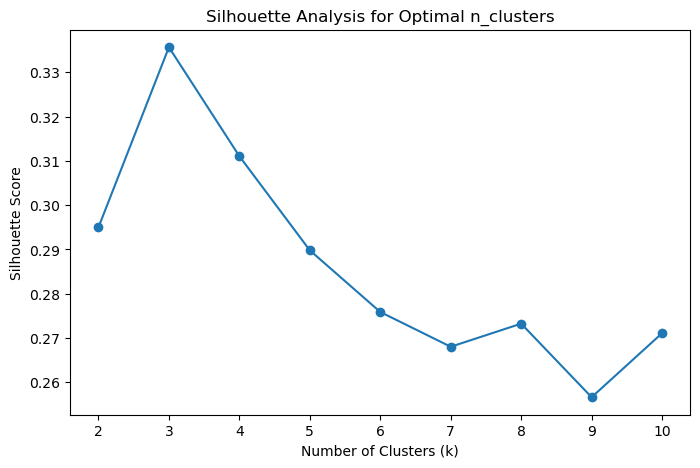

In [285]:
# Kmean to estimate the optimal number of clusters by Silhouette Score

silhouette_scores = []
range_n_clusters = range(2, 11)
for n_clusters in range_n_clusters:
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    labels = kmeans.fit_predict(features_1hvy)
    silhouette_scores.append(silhouette_score(features_1hvy, labels))

# Plot the silhouette scores
plt.figure(figsize=(8, 5))
plt.plot(range_n_clusters, silhouette_scores, marker='o')
plt.title("Silhouette Analysis for Optimal n_clusters")
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Silhouette Score")
plt.show()

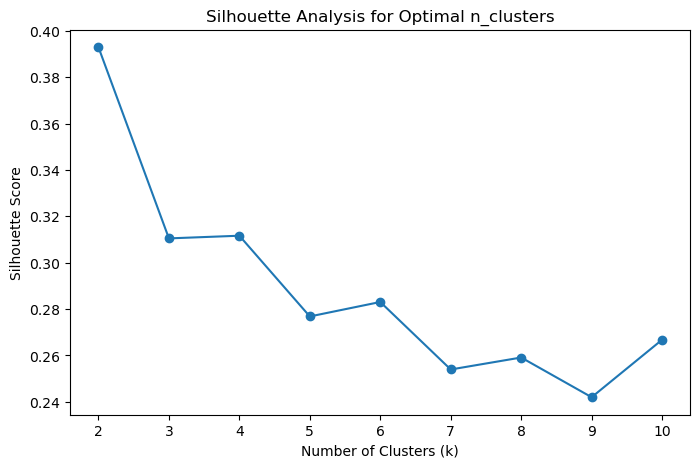

In [286]:
silhouette_scores = []
range_n_clusters = range(2, 11)
for n_clusters in range_n_clusters:
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    labels = kmeans.fit_predict(features_2bal)
    silhouette_scores.append(silhouette_score(features_2bal, labels))

# Plot the silhouette scores
plt.figure(figsize=(8, 5))
plt.plot(range_n_clusters, silhouette_scores, marker='o')
plt.title("Silhouette Analysis for Optimal n_clusters")
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Silhouette Score")
plt.show()

Number of clusters: 2, Silhouette Score: 0.2950
Number of clusters: 3, Silhouette Score: 0.3357
Number of clusters: 4, Silhouette Score: 0.3111
Number of clusters: 5, Silhouette Score: 0.3042
Number of clusters: 6, Silhouette Score: 0.2915
Number of clusters: 7, Silhouette Score: 0.2814
Number of clusters: 8, Silhouette Score: 0.2838
Number of clusters: 9, Silhouette Score: 0.2753
Number of clusters: 10, Silhouette Score: 0.2700


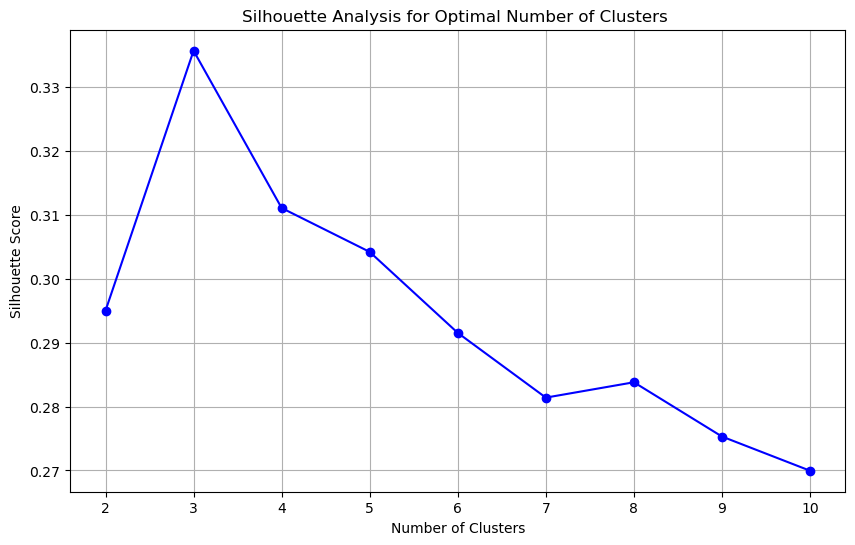

Optimal number of clusters suggested by silhouette analysis: 3


In [287]:


def silhouette_analysis(data, min_clusters=2, max_clusters=10):
    """
    Perform silhouette analysis to determine the optimal number of clusters.
    
    Args:
        data (numpy.ndarray or pandas.DataFrame): The data to cluster (e.g., 3D coordinates + p(bind)).
        min_clusters (int): Minimum number of clusters to test (must be >= 2).
        max_clusters (int): Maximum number of clusters to test.
    
    Returns:
        int: Suggested number of clusters based on the highest silhouette score.
    """
    if min_clusters < 2:
        raise ValueError("min_clusters must be 2 or higher for silhouette analysis.")
    
    silhouette_scores = []
    cluster_range = range(min_clusters, max_clusters + 1)

    for n_clusters in cluster_range:
        kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)
        cluster_labels = kmeans.fit_predict(data)

        # Calculate the silhouette score
        score = silhouette_score(data, cluster_labels)
        silhouette_scores.append(score)
        print(f"Number of clusters: {n_clusters}, Silhouette Score: {score:.4f}")

    # Find the number of clusters with the highest silhouette score
    optimal_clusters = cluster_range[np.argmax(silhouette_scores)]

    # Plot the silhouette scores
    plt.figure(figsize=(10, 6))
    plt.plot(cluster_range, silhouette_scores, marker='o', linestyle='-', color='b')
    plt.xlabel("Number of Clusters")
    plt.ylabel("Silhouette Score")
    plt.title(f"Silhouette Analysis for Optimal Number of Clusters ")
    plt.xticks(cluster_range)
    plt.grid()
    plt.show()

    print(f"Optimal number of clusters suggested by silhouette analysis: {optimal_clusters}")
    return optimal_clusters

# Example Usage:
# Pass the dataset `data` and specify the cluster range.
# data = np.array([[x, y, z, p_bind], ...])
suggested_clusters = silhouette_analysis(features_1hvy, min_clusters=2, max_clusters=10)

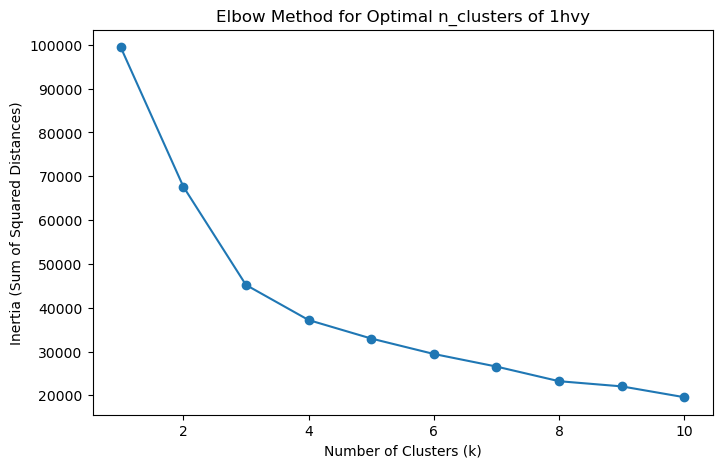

In [288]:
# Determine inertia for a range of cluster numbers
inertia = []
range_n_clusters = range(1, 11)
for n_clusters in range_n_clusters:
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    kmeans.fit(features_1hvy)
    inertia.append(kmeans.inertia_)

# Plot the elbow curve
plt.figure(figsize=(8, 5))
plt.plot(range_n_clusters, inertia, marker='o')
plt.title("Elbow Method for Optimal n_clusters of 1hvy")
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Inertia (Sum of Squared Distances)")
plt.show()

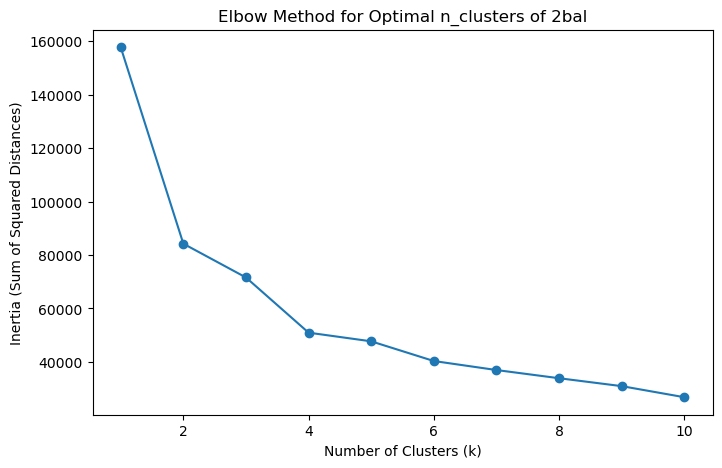

In [289]:
# Determine inertia for a range of cluster numbers
inertia = []
range_n_clusters = range(1, 11)
for n_clusters in range_n_clusters:
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    kmeans.fit(features_2bal)
    inertia.append(kmeans.inertia_)

# Plot the elbow curve
plt.figure(figsize=(8, 5))
plt.plot(range_n_clusters, inertia, marker='o')
plt.title("Elbow Method for Optimal n_clusters of 2bal")
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Inertia (Sum of Squared Distances)")
plt.show()

In [290]:
# Kmean function to estimate the optimal number of clusters by Elbow Method

def calculate_inertia(data, max_clusters=10):
    """
    Calculate the inertia (sum of squared distances) for a range of clusters.
    
    Args:
        data (array-like): Dataset to cluster.
        max_clusters (int): Maximum number of clusters to evaluate.

    Returns:
        list: Inertia values for each number of clusters.
    """
    inertia = []
    for n_clusters in range(1, max_clusters + 1):
        kmeans = KMeans(n_clusters=n_clusters, random_state=42)
        kmeans.fit(data)
        inertia.append(kmeans.inertia_)
    return inertia

def plot_elbow_curve(inertia, max_clusters=10):
    """
    Plot the elbow curve for the given inertia values.

    Args:
        inertia (list): Inertia values for each number of clusters.
        max_clusters (int): Maximum number of clusters to evaluate.
    """
    plt.figure(figsize=(8, 5))
    plt.plot(range(1, max_clusters + 1), inertia, marker='o')
    plt.title("Elbow Method for Optimal n_clusters")
    plt.xlabel("Number of Clusters (k)")
    plt.ylabel("Inertia (Sum of Squared Distances)")
    plt.show()

def suggest_n_clusters_elbow(inertia):
    """
    Suggest the optimal number of clusters based on the elbow method.

    Args:
        inertia (list): Inertia values for each number of clusters.

    Returns:
        int: Suggested number of clusters.
    """
    diffs = np.diff(inertia)  # First derivative
    second_diffs = np.diff(diffs)  # Second derivative
    suggested_k = np.argmax(second_diffs) + 2  # +2 because second_diffs starts at k=3
    return suggested_k

def silhouette_analysis(data, max_clusters=10):
    """
    Perform silhouette analysis for a range of clusters and suggest optimal n_clusters.

    Args:
        data (array-like): Dataset to cluster.
        max_clusters (int): Maximum number of clusters to evaluate.

    Returns:
        tuple: Suggested n_clusters, silhouette scores for each k.
    """
    silhouette_scores = []
    for n_clusters in range(2, max_clusters + 1):  # Silhouette analysis starts at k=2
        kmeans = KMeans(n_clusters=n_clusters, random_state=42)
        labels = kmeans.fit_predict(data)
        silhouette_scores.append(silhouette_score(data, labels))
    suggested_k = np.argmax(silhouette_scores) + 2  # +2 because silhouette_scores starts at k=2
    return suggested_k, silhouette_scores

def plot_silhouette_analysis(silhouette_scores, max_clusters=10):
    """
    Plot silhouette scores for a range of clusters.

    Args:
        silhouette_scores (list): Silhouette scores for each number of clusters.
        max_clusters (int): Maximum number of clusters to evaluate.
    """
    plt.figure(figsize=(8, 5))
    plt.plot(range(2, max_clusters + 1), silhouette_scores, marker='o', color='orange')
    plt.title("Silhouette Analysis for Optimal n_clusters")
    plt.xlabel("Number of Clusters (k)")
    plt.ylabel("Silhouette Score")
    plt.show()

def compare_methods(data, max_clusters=10):
    """
    Compare elbow method and silhouette analysis to suggest n_clusters.

    Args:
        data (array-like): Dataset to cluster.
        max_clusters (int): Maximum number of clusters to evaluate.

    Returns:
        tuple: Suggested n_clusters from elbow method and silhouette analysis.
    """
    # Calculate metrics
    inertia = calculate_inertia(data, max_clusters)
    suggested_k_elbow = suggest_n_clusters_elbow(inertia)
    suggested_k_silhouette, silhouette_scores = silhouette_analysis(data, max_clusters)

    # Print suggested cluster numbers
    print(f"Suggested n_clusters (Elbow Method): {suggested_k_elbow}")
    print(f"Suggested n_clusters (Silhouette Analysis): {suggested_k_silhouette}")

    # Plot Elbow Curve and Silhouette Analysis side by side
    fig, axes = plt.subplots(1, 2, figsize=(16, 6))  # Create side-by-side subplots

    # Elbow Curve
    axes[0].plot(range(1, max_clusters + 1), inertia, marker='o')
    axes[0].set_title(f"Elbow Method for Optimal {suggested_k_elbow} clusters")
    axes[0].set_xlabel("Number of Clusters (k)")
    axes[0].set_ylabel("Inertia (Sum of Squared Distances)")

    # Silhouette Analysis
    axes[1].plot(range(2, max_clusters + 1), silhouette_scores, marker='o', color='orange')
    axes[1].set_title(f"Silhouette Analysis for Optimal {suggested_k_silhouette} clusters")
    axes[1].set_xlabel("Number of Clusters (k)")
    axes[1].set_ylabel("Silhouette Score")

    # Adjust layout and show the plots
    plt.tight_layout()
    plt.show()

    return suggested_k_elbow, suggested_k_silhouette

Suggested n_clusters (Elbow Method): 3
Suggested n_clusters (Silhouette Analysis): 3


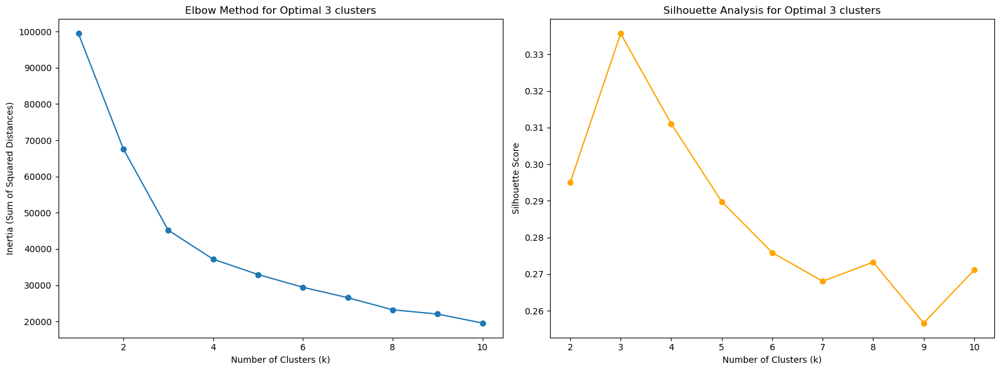

In [291]:
# Estimate the optimal number of clusters of 1hvy

# Example Usage
# Replace `features_1hvy` with your dataset
max_clusters = 10
elbow_k, silhouette_k = compare_methods(features_1hvy, max_clusters)

Suggested n_clusters (Elbow Method): 2
Suggested n_clusters (Silhouette Analysis): 2


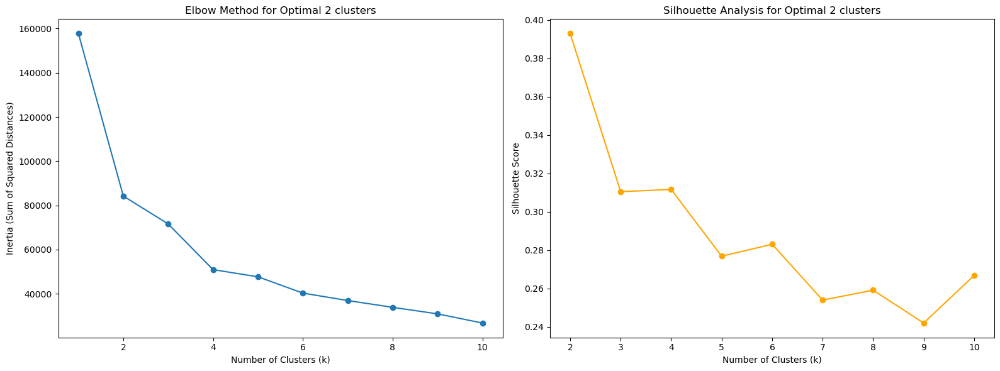

In [292]:
# Estimate the optimal number of clusters for 2bal
elbow_k, silhouette_k = compare_methods(features_2bal, max_clusters)

In [222]:
# Perform KMeans clustering with the suggested number of clusters
def perform_kmeans_clustering(data, feature_columns, n_clusters):
    """
    Perform KMeans clustering on the specified feature columns of a DataFrame.

    Args:
        data (pd.DataFrame): Input DataFrame containing the features.
        feature_columns (list): List of column names to use for clustering.
        n_clusters (int): Number of clusters for KMeans.

    Returns:
        pd.DataFrame: DataFrame with an additional column 'kmean_cluster' for cluster labels.
    """
    # Ensure the feature columns exist in the DataFrame
    if not all(col in data.columns for col in feature_columns):
        missing_cols = [col for col in feature_columns if col not in data.columns]
        raise ValueError(f"Missing columns in DataFrame: {missing_cols}")
    
    # Extract the features for clustering
    features = data[feature_columns].values
    
    # Perform KMeans clustering
    kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init="auto")
    data['kmean_cluster'] = kmeans.fit_predict(features)
    
    return data

In [238]:
# Specify the feature columns for clustering
feature_columns = ['center_of_mass_x', 'center_of_mass_y', 'center_of_mass_z', 'p(bind)']

n_clusters = suggest_n_clusters_elbow
# Perform KMeans clustering
features_1hvy = perform_kmeans_clustering(features_1hvy, feature_columns, n_clusters=2)

# Count the occurrences of each cluster
print(features_1hvy['kmean_cluster'].value_counts())

# Display the DataFrame with the new 'kmean_cluster' column
features_1hvy.head()

kmean_cluster
0    352
1    224
Name: count, dtype: int64


,center_of_mass_x,center_of_mass_y,center_of_mass_z,p(bind),kmean_cluster
991,-13.400,21.884,-8.280,0.011475,0
992,-13.141,18.596,-6.060,0.013097,0
993,-10.895,20.576,-1.019,0.004663,0
994,-9.064,17.272,-0.993,0.019464,0
995,-9.866,18.445,3.560,0.013421,0


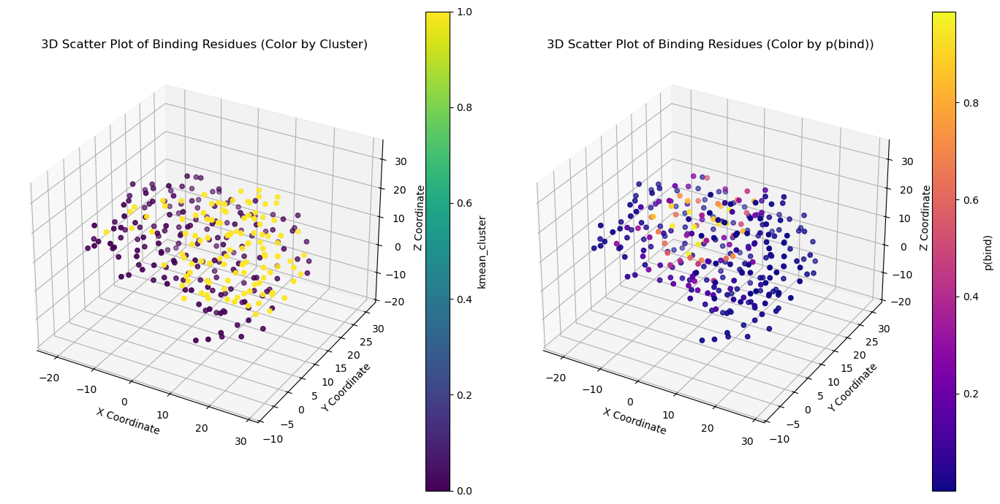

In [250]:
# Visualize the clustering results using a 3D scatter plot
plot_3d_pbind_cluster(features_1hvy, 'kmean_cluster')

In [257]:
import py3Dmol
pdb_file = f"{data_path}/1hvy.pdb"

def visualize_pdb_in_notebook(pdb_file):
    """
    Visualize a PDB structure in Jupyter Notebook using py3Dmol.

    Args:
        pdb_file (str): Path to the PDB file.
    """
    # Read the PDB file
    with open(pdb_file, 'r') as file:
        pdb_data = file.read()

    # Create a viewer
    viewer = py3Dmol.view(width=800, height=400)
    viewer.addModel(pdb_data, 'pdb')  # Load the PDB structure
    viewer.setStyle({'cartoon': {'color': 'spectrum'}})  # Display as cartoon with spectrum coloring
    viewer.zoomTo()  # Auto-zoom to the structure
    #viewer.setStyle({'cartoon': {'color': 'chain'}})
    viewer.addStyle({'chain': 'A', 'resi': [50, 60]}, {'stick': {'color': 'red'}})
    #viewer.addSurface(py3Dmol.SAS, {'opacity': 0.7})
    return viewer.show()

# Example usage
visualize_pdb_in_notebook(pdb_file)
# viewer.addStyle({'chain': 'A', 'resi': [50, 60]}, {'stick': {'color': 'red'}})
# viewer.setStyle({'stick': {}})


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [263]:
df_1hvy = combined_df.loc[combined_df['PDBcode'] == '1hvy']
# Visualize and highlight residues
viewer = py3Dmol.view(width=800, height=400)
viewer.addModel(open(pdb_file, 'r').read(), 'pdb')
viewer.setStyle({'cartoon': {'color': 'grey'}})

# Highlight residues with high p(bind)
for _, row in df_1hvy.iterrows():
    if row['p(bind)'] > 0.5:  # Example threshold
        viewer.addStyle({'chain': row['chain'], 'resi': int(row['resi'])}, {'stick': {'color': 'red'}})

# Highlight ligands
viewer.addStyle({'hetflag': True}, {'stick': {'colorscheme': 'yellowCarbon'}})

# Display the structure in grey
viewer.zoomTo()
viewer.show()

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [267]:
df_1hvy.sort_values(by='p(bind)', ascending=False).head(n=20)

,chain,resi,resn,p(bind),resn_coordinates,center_of_mass_x,center_of_mass_y,center_of_mass_z,PDBcode
1160,A,195,C,0.987738,"[('N', 4.371, 2.944, 11.85), ('C', 3.002, 2.97...",2.662,3.422,11.735,1hvy
5572,A,195,C,0.987738,"[('N', 4.371, 2.944, 11.85), ('C', 3.002, 2.97...",2.662,3.422,11.735,1hvy
1187,A,222,G,0.985464,"[('N', -2.831, 10.987, 14.4), ('C', -1.728, 10...",-1.875,11.229,12.765,1hvy
5599,A,222,G,0.985464,"[('N', -2.831, 10.987, 14.4), ('C', -1.728, 10...",-1.875,11.229,12.765,1hvy
1073,A,108,I,0.981758,"[('N', 5.901, 15.285, 20.404), ('C', 5.141, 14...",5.333,13.974,18.960,1hvy
5485,A,108,I,0.981758,"[('N', 5.901, 15.285, 20.404), ('C', 5.141, 14...",5.333,13.974,18.960,1hvy
5595,A,218,D,0.956156,"[('N', -4.322, 6.22, 12.976), ('C', -5.151, 6....",-4.995,7.840,14.802,1hvy
1183,A,218,D,0.956156,"[('N', -4.322, 6.22, 12.976), ('C', -5.151, 6....",-4.995,7.840,14.802,1hvy
1186,A,221,L,0.946414,"[('N', -5.808, 11.641, 15.198), ('C', -4.531, ...",-3.921,12.281,16.333,1hvy
5598,A,221,L,0.946414,"[('N', -5.808, 11.641, 15.198), ('C', -4.531, ...",-3.921,12.281,16.333,1hvy


In [ ]:
is tit

In [235]:
plot_3d_scatter(features_1hvy, 'p(bind)')

In [229]:
features_1hvy.value_counts('kmean_cluster')

kmean_cluster
0    352
1    224
Name: count, dtype: int64

3. Use DBCAN clustering

DBSCAN (Density-Based Spatial Clustering of Applications with Noise) is different from algorithms like K-Means because it doesn’t directly allow you to specify the number of clusters (n_clusters). Instead, it identifies clusters based on the density of data points in a specified neighborhood. The two key parameters in DBSCAN are:
	
1.	eps (epsilon): The radius of the neighborhood for a point to be considered part of a cluster.

2.	min_samples: The minimum number of points required to form a dense region (cluster).

Why max_n_clusters is not directly supported

DBSCAN determines clusters based on density rather than a predefined number of clusters, so you cannot directly set max_n_clusters. However, you can:
	•	Tune eps and min_samples to control the clustering result.
	•	Evaluate the number of clusters found for different values of eps and adjust until the desired range of clusters is achieved.

Indirect Control of max_n_clusters

To indirectly control the number of clusters:
1.	Experiment with eps and min_samples:
	•	Lower eps results in smaller clusters and potentially more clusters.
	•	Higher eps results in larger clusters and fewer clusters.
	
2.	Use a loop to vary eps and find a configuration where the number of clusters is within your desired range.

In [199]:
from sklearn.cluster import DBSCAN

dbscan = DBSCAN(eps=0.5, min_samples=1)  # Adjust parameters as needed
labels = dbscan.fit_predict(features_1hvy)

# Check the number of clusters formed
n_clusters = len(set(labels)) - (1 if -1 in labels else 0)
print(f"Number of clusters found: {n_clusters}")

Number of clusters found: 288


In [207]:
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score
import numpy as np

def find_dbscan_clusters(data, min_samples=5, min_clusters=2, max_clusters=10):
    """
    Find DBSCAN parameters (eps) to achieve a target range of clusters.
    
    Args:
        data (array-like): Dataset to cluster.
        min_samples (int): Minimum number of points in a neighborhood for a cluster.
        min_clusters (int): Minimum number of clusters desired.
        max_clusters (int): Maximum number of clusters desired.
    
    Returns:
        tuple: Best eps value, number of clusters, and cluster labels.
    """
    best_eps = None
    best_n_clusters = 0
    best_labels = None
    eps_values = np.linspace(0.1, 5, 50)  # Adjust range and resolution of eps values

    for eps in eps_values:
        dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        labels = dbscan.fit_predict(data)
        
        # Count the number of clusters (ignoring noise points labeled as -1)
        n_clusters = len(set(labels)) - (1 if -1 in labels else 0)

        if min_clusters <= n_clusters <= max_clusters:
            best_eps = eps
            best_n_clusters = n_clusters
            best_labels = labels
            break  # Stop as soon as we find a suitable configuration

    if best_eps is not None:
        print(f"Found {best_n_clusters} clusters with eps={best_eps:.2f}")
    else:
        print("Could not find suitable eps value for the desired cluster range.")
    
    return best_eps, best_n_clusters, best_labels

# Example Usage
#data = np.random.rand(100, 3)  # Replace with your dataset
best_eps, best_n_clusters, labels = find_dbscan_clusters(features_2bal, min_samples=5, min_clusters=2, max_clusters=10)

Found 2 clusters with eps=4.80


In [208]:
find_dbscan_clusters(features_1hvy, min_samples=5, min_clusters=2, max_clusters=10)

Found 2 clusters with eps=3.80


(3.8000000000000003,
 2,
 array([-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1,  0,  0,  0,  0, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1,  1,  1,  1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,

In [212]:
from sklearn_extra.cluster import QuickShiftTS
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler

def quality_threshold_clustering(data, threshold=1.0):
    """
    Perform Quality Threshold (QT) clustering on the dataset.

    Args:
        data (array-like): Dataset to cluster (3D coordinates and binding probabilities).
        threshold (float): Diameter threshold for clusters.

    Returns:
        labels (array): Cluster labels for each point in the dataset.
    """
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data)

    # Perform QT clustering using QuickShift
    qt_cluster = QuickShift(bandwidth=threshold)
    labels = qt_cluster.fit_predict(scaled_data)

    return labels

def plot_qt_clusters(data, labels):
    """
    Plot the QT clusters in a 3D scatter plot.

    Args:
        data (array-like): Dataset (3D coordinates and binding probabilities).
        labels (array): Cluster labels.
    """
    # Convert data to a DataFrame for easy visualization
    df = pd.DataFrame(data, columns=["x", "y", "z", "p(bind)"])
    df["cluster"] = labels

    # Plot the clusters
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection="3d")
    scatter = ax.scatter(df["x"], df["y"], df["z"], c=df["cluster"], cmap="viridis", s=20)
    legend1 = ax.legend(*scatter.legend_elements(), title="Clusters")
    ax.add_artist(legend1)

    ax.set_title("Quality Threshold Clustering")
    ax.set_xlabel("X")
    ax.set_ylabel("Y")
    ax.set_zlabel("Z")
    plt.show()

# Example dataset (3D coordinates and binding probabilities)
data = np.array([
    [0.278, 5.563, 4.292, 0.018384],
    [5.402, 4.791, -0.104, 0.019465],
    [2.582, 6.853, -3.118, 0.052141],
    [8.616, 3.762, -5.395, 0.015975],
    [4.960, 0.485, -0.997, 0.008017]
])

# Run QT clustering
threshold = 1.5  # Adjust threshold as needed
labels = quality_threshold_clustering(features_1hvy, threshold)

# Plot the clusters
plot_qt_clusters(features_1hvy, labels)

ImportError: cannot import name 'QuickShiftTS' from 'sklearn_extra.cluster' (/opt/miniconda3/envs/protein_pp/lib/python3.11/site-packages/sklearn_extra/cluster/__init__.py)

In [216]:
from scipy.spatial.distance import pdist, squareform
import numpy as np

def quality_threshold_clustering(data, diameter):
    data = np.array(data)
    dist_matrix = squareform(pdist(data))  # Compute pairwise distances
    clusters = []
    unclustered_points = set(range(len(data)))

    while unclustered_points:
        # Initialize a new cluster
        cluster = set()
        for idx in unclustered_points:
            # Find neighbors within the diameter
            neighbors = set(np.where(dist_matrix[idx] <= diameter)[0])
            if len(neighbors) > len(cluster):
                cluster = neighbors
        # Add the best cluster
        clusters.append(cluster)
        unclustered_points -= cluster
        print(f"Found cluster with {len(cluster)} points")

    return clusters

# Example dataset
data = [[1, 2], [1, 4], [1, 0], [10, 2], [10, 4], [10, 0]]
clusters = quality_threshold_clustering(features_1hvy, diameter=3.0)
print("Clusters:", clusters)

Found cluster with 4 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2 points
Found cluster with 2

In [219]:
clusters = quality_threshold_clustering(features_1hvy, diameter=15.0)
print("Clusters:", clusters)

Found cluster with 182 points
Found cluster with 168 points
Found cluster with 160 points
Found cluster with 108 points
Found cluster with 100 points
Found cluster with 90 points
Found cluster with 88 points
Found cluster with 86 points
Found cluster with 80 points
Found cluster with 78 points
Found cluster with 74 points
Found cluster with 68 points
Found cluster with 68 points
Found cluster with 66 points
Found cluster with 62 points
Found cluster with 58 points
Clusters: [{512, 541, 543, 547, 549, 550, 39, 40, 41, 551, 552, 553, 45, 46, 47, 554, 555, 557, 558, 55, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 109, 110, 113, 114, 133, 134, 135, 136, 138, 139, 140, 141, 142, 143, 151, 152, 153, 154, 155, 170, 171, 172, 173, 174, 175, 176, 177, 181, 182, 183, 184, 185, 186, 188, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 253, 255, 259, 261, 262, 263, 264, 265, 266, 267, 269, 270, 327, 328, 329, 333

### Install the nescessary library to visualize the protein-ligand complex



In [161]:
import nglview
import ipywidgets

from biobb_io.api.pdb import pdb

In [162]:
#pdb_code = "3HEC"         # P38 + Imatinib
#ligand_code = "STI"       # Imatinib

#1ao6            Serum albumin      
pdb_code = "1ao6"         
ligand_code = "D16" 

pockets_dir = "pockets"
download_pdb = "download.pdb"
prop = {
  "pdb_code": pdb_code,
  "filter": ["ATOM", "HETATM"]
}

pdb(output_pdb_path=download_pdb,
    properties=prop)

view = nglview.show_structure_file(download_pdb)
view.center()
view._remote_call('setSize', target='Widget', args=['100%', '600px'])
view

2025-01-14 21:38:27,868 [MainThread  ] [INFO ]  Module: biobb_io.api.pdb Version: 5.0.1
2025-01-14 21:38:27,868 [MainThread  ] [INFO ]  Downloading 1ao6 from: https://www.ebi.ac.uk/pdbe/entry-files/download/pdb1ao6.ent
2025-01-14 21:38:28,152 [MainThread  ] [INFO ]  Writting pdb to: download.pdb
2025-01-14 21:38:28,153 [MainThread  ] [INFO ]  Filtering lines NOT starting with one of these words: ['ATOM', 'HETATM']
2025-01-14 21:38:28,163 [MainThread  ] [INFO ]  


NGLWidget()

In [163]:
from biobb_structure_utils.utils.extract_molecule import extract_molecule

pdb_protein = "pdb_protein.pdb"

extract_molecule(input_structure_path=download_pdb,
             output_molecule_path = pdb_protein)
            

2025-01-14 21:38:28,216 [MainThread  ] [INFO ]  Module: biobb_structure_utils.utils.extract_molecule Version: 5.0.0
2025-01-14 21:38:28,217 [MainThread  ] [INFO ]  /Users/nicha/dev/Protein-preparation-pipeline/src/binding_sites_clustering/sandbox_a3e10205-df61-4548-bb71-21661c68f470 directory successfully created
2025-01-14 21:38:28,219 [MainThread  ] [INFO ]  Copy: /Users/nicha/dev/Protein-preparation-pipeline/src/binding_sites_clustering/download.pdb to /Users/nicha/dev/Protein-preparation-pipeline/src/binding_sites_clustering/sandbox_a3e10205-df61-4548-bb71-21661c68f470
2025-01-14 21:38:28,220 [MainThread  ] [INFO ]  Creating 364ffecd-5da4-4735-bcf9-85cd296fad81 temporary folder
2025-01-14 21:38:28,222 [MainThread  ] [INFO ]  check_structure -i /Users/nicha/dev/Protein-preparation-pipeline/src/binding_sites_clustering/download.pdb -o pdb_protein.pdb --force_save --non_interactive command_list --list 364ffecd-5da4-4735-bcf9-85cd296fad81/extract_prot.lst

2025-01-14 21:38:28,687 [Main

0

In [164]:
view = nglview.show_structure_file(pdb_protein, default=False)
view.add_representation(repr_type='cartoon', 
                        selection='not het',
                       colorScheme = 'atomindex')
view.center()
view._remote_call('setSize', target='Widget', args=['','600px'])

view

NGLWidget()

In [165]:
from biobb_vs.fpocket.fpocket_run import fpocket_run

fpocket_all_pockets = "fpocket_all_pockets.zip"
fpocket_summary = "fpocket_summary.json"
prop = {
    "min_radius": 3,
    "max_radius": 6,
    "num_spheres": 35
}

fpocket_run(input_pdb_path=pdb_protein,
        output_pockets_zip = fpocket_all_pockets,
        output_summary=fpocket_summary,
        properties=prop)


2025-01-14 21:38:28,764 [MainThread  ] [INFO ]  Module: biobb_vs.fpocket.fpocket_run Version: 5.0.0
2025-01-14 21:38:28,765 [MainThread  ] [INFO ]  /Users/nicha/dev/Protein-preparation-pipeline/src/binding_sites_clustering/sandbox_8aef5f4d-c8d4-4e86-b4db-c5cdb3ae6fb8 directory successfully created
2025-01-14 21:38:28,768 [MainThread  ] [INFO ]  Copy: pdb_protein.pdb to /Users/nicha/dev/Protein-preparation-pipeline/src/binding_sites_clustering/sandbox_8aef5f4d-c8d4-4e86-b4db-c5cdb3ae6fb8
2025-01-14 21:38:28,770 [MainThread  ] [INFO ]  Creating 02af10aa-1cf1-4f3e-baf6-49b048b5d029 temporary folder
2025-01-14 21:38:28,771 [MainThread  ] [INFO ]  Executing fpocket
2025-01-14 21:38:28,772 [MainThread  ] [INFO ]  fpocket -f 02af10aa-1cf1-4f3e-baf6-49b048b5d029/input.pdb -m 3 -M 6 -i 35

2025-01-14 21:38:28,788 [MainThread  ] [INFO ]  Executing: fpocket -f 02af10aa-1cf1-4f3e-baf6-49b048b5d029/input.pdb -m 3 -M 6 -i 35...
2025-01-14 21:38:28,789 [MainThread  ] [INFO ]  Exit code: 127
2025-01-1

SystemExit: FPocketRun: Error executing fpocket, please check your properties